# Praktikum Deep Learning

# Optimierung

## Mathematische Hintergrund

Während der Training "lernt" Neurale Netzwerk die Gewichte ihrer Schichten. Es wird in Raum dieser Paramer nach so eine Kombination gesucht, die möglischt minimale Loss-funktion liefert.
Allgemein kann man das Loss auf folgende Weise darstellen:
$L(W) = \frac{1}{N}\Sigma_{i=1}^{n}L_i(f(x_i, W), y_i)+\lambda R(W)$ .
Das beschreibt einen Landschaft in Raum der Parameter $W$. 
Da diese Räume in Anwendungsfällen Tausende und Millionen Dimensional sein können, wird das Minimimum nicht analytisch gesucht, sondern auf folgende Weise.
Aus dem Ausgangspunkt(wie man es auswählt - später) beginnt Algorithmus anhand des Gradients, der relativ einfach sich durck Backpropagation berechnen lässt, das Weg in Richtung Maximale Neigung.
Der Basis diese Idee entspricht der einfachste Algorithmus von Optimierung-Familie - *Stohastic Gradient Descent (SGD)*.

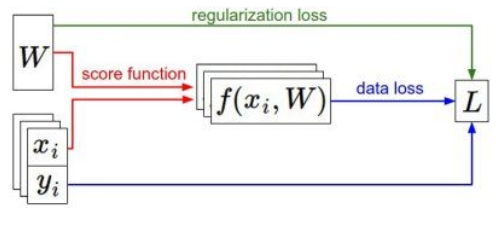

In deisen Teil werden wir ein künstlich erstellten einfaches Beispiel betrachten. In [Teil 2](./Optimierung-p2.html) werden wir uns neurale Netzwerk mit MNIST dataset zuwenden.

## Einfaches Beispiel

Lassen uns Loss Funktion von 2 Parameter $W_1$ and $W_2$ wie folgende Paraboloid vorstellen. In der Realität werden die Trainingdaten wahrscheinlich stohastische Erregungen enthalten. Um das zu simulieren wird Graideint zufällige Störung enthalten und Loss-Landschaft mit stohastischen Erregung definiert. Das Minima findet sich trotzdenm in $(0,0)$.

In [32]:
import plotly.graph_objects as go
import numpy as np
import plotly.offline

plotly.offline.init_notebook_mode(connected=True)

size=100
from scipy import interpolate
x = np.linspace(-10, 10, size)
y = np.linspace(-10, 10, size)
xx, yy = np.meshgrid(x, y)
z = xx*xx+yy*yy+np.random.rand(size,size)*2 
z2 = xx**3-3*xx*yy**2 #ist auch nicht schlecht
f = interpolate.RectBivariateSpline(x,y,z)
f2= interpolate.RectBivariateSpline(x,y,z)
fig = go.Figure(data=[go.Surface(x=x,y=y,z=z)])
fig.update_traces(contours_z=dict(show=True, usecolormap=True,
                                  highlightcolor="limegreen", project_z=True))
fig.update_layout(title='Loss function', autosize=False,
                  scene_camera_eye=dict(x=2, y=2, z=2),
                  width=800, height=800,
                  margin=dict(l=15, r=20, b=15, t=60)
)
fig.add_surface
fig.show()

Algorithmus (noch nicht als schön Anwendbare Funktion) liegt in folgende Code-Zelle:

In [33]:
def evaluate_gradient(x,y,f):
  temp = np.array([f(x,y,dx=1,dy=0).item(0),f(x,y,dx=0,dy=1).item(0)])
  temp = temp#+np.random.randn(2)/10
  return temp
  #return np.ndarray(shape=(1,2),buffer=temp)
learning_rate = 0.01
x_start, y_start = (-9 , 8)
gd1=[np.array([x_start,y_start])]
for i in range(5000):
  xtemp=gd1[-1][0]
  ytemp=gd1[-1][1]
  weights_grad = evaluate_gradient(xtemp,ytemp,f)
  test= gd1[-1] - learning_rate * weights_grad
  gd1.append(test)
gd1_x = np.asarray([item.dot(np.array([1,0])) for item in gd1])
gd1_y = np.asarray([item.dot(np.array([0,1])) for item in gd1])
gd1_z = []
for i in range(len(gd1)):
  gd1_z.append(f(gd1_x[i],gd1_y[i]).item(0)+2)
gd1_z=np.array(gd1_z)
#print(gd1_z)
fig = go.Figure(data=[go.Surface(x=x,y=y,z=z),go.Scatter3d(x=gd1_x,y=gd1_y,z=gd1_z,line=dict(
        color='red',
        width=3
    ))])
#fig.update_traces(contours_z=dict(show=True, usecolormap=True,
#                                  highlightcolor="limegreen", project_z=True))
fig.update_layout(title='Loss function', autosize=False,
                  scene_camera_eye=dict(x=2, y=2, z=2),
                  width=800, height=800,
                  margin=dict(l=15, r=20, b=15, t=60)
)
fig.add_surface
fig.show()
 

Auch in so einfachen Fall wegen stohastischen Störungen kann *SGD* das beste Minima nicht und "bewegt sich" etwa langsam (das wird später deutlicher gezeigt).

## Optimierung Algorithmen
### Etwa komplizierteres Loss-Landschaft

Lassen uns ein Landschaft vorstellen, das mehrere lokale Minima,Maxima und Sattelpunkte besitzt:

In [34]:
#@title
xsize=500
ysize=500
zsize=xsize*ysize
x = np.linspace(-12,12,xsize)
y = np.linspace(-12,12,ysize)
xx, yy = np.meshgrid(x, y)
#z= np.cos((xx-1)/6)*np.cos((yy+2)/6)*np.exp(-((xx-1)**2)/12-((yy+2)**2)/12)+ \
#        np.cos((xx+3)/6)*np.cos((yy-1)/6)*np.exp(-((xx+3)**2)/12-((yy-1)**2)/12)
#temp_points = np.random.randn(3,4)*10-5
#print(temp_points[1][1])
#z= np.sum(np.cos((xx-temp_points[1][1])/6)*np.cos((yy+temp_points[1][2])/6)*np.exp(-((xx-1)**2)/12-((yy+2)**2)/12))
z = np.sin(1*xx)*np.exp(-xx**2/10)*(0.75*xx**2-1*xx+1)*np.cos(0.6*yy+1)*0.5*np.exp(-yy**2/10)*(0.5*yy**2+yy+1)#+np.random.rand(xsize,ysize)*0.5#+np.exp(+(xx/10)**2+(yy/10)**2)
#f = interpolate.RectBivariateSpline(x,y,z)
f=interpolate.interp2d(x,y,z,kind='cubic')
fig = go.Figure(data=[go.Surface(x=x,y=y,z=z)])
fig.update_traces(contours_z=dict(show=True, usecolormap=True,
                                  highlightcolor="limegreen", project_z=True))
fig.update_layout(title='Loss function', autosize=True,
                  scene_camera_eye=dict(x=2, y=2, z=2),
                  width=800, height=800,
                  margin=dict(l=15, r=20, b=15, t=60)
)
fig.add_surface
fig.show()

Wir wählen folgende Learning Rate Hyperparameter und Anfangspunkt.

In [35]:
xstart=-2 #-2 was fun
ystart=2
learning_rate=1e-1
steps=1000

### SGD Klassisch

Simplifiziert lässt sich sagen, dass wir ein kleines Schritt (abhängig von *Learning Rate*) in der richtung maximale Neigung (beeinflüßt von stohastischen Erregungen) machen. Das einfaschste Algorythmus, es ist abhängig von *Learning Rate* ($\alpha$): Schritte zu klein, die stochatische Erregungen werden nicht lassen Lösung zum Minima zu entwickeln, Schritte zu groß weden nicht konvergieren. \
$x_{t+1}=x_t-\alpha \nabla f(x_t)$

In [36]:
def SGD(x_start,y_start,f,learning_rate,steps):
  sgd=[np.array([x_start,y_start])]
  #print(sgd)
  for i in range(steps):
    xtemp=sgd[-1][0]
    ytemp=sgd[-1][1]
    weights_grad = evaluate_gradient(xtemp,ytemp,f)
    test= sgd[-1] - learning_rate * weights_grad
    #print(weights_grad)
    #print(sgd[-1])
    #print(test)
    sgd.append(test)
  sgd_x = np.asarray([item.dot(np.array([1,0])) for item in sgd])
  sgd_y = np.asarray([item.dot(np.array([0,1])) for item in sgd])
  sgd_z = []
  for i in range(len(sgd)):
    sgd_z.append(f(sgd_x[i],sgd_y[i]).item(0)+0.2) #+1 to see better
  sgd_z=np.array(sgd_z)
  return sgd_x, sgd_y, sgd_z

x1,y1,z1 = SGD(xstart,ystart,f,learning_rate,steps)

### SGD mit Momentum

Weiterentwicklung von **SGD** Algorythmus. Das Update von Gewichte erfolgt in der Rischtung von aggregierte Gradienten mit gewissenen "*Decay*" (Der Schritt wird in Richtung "leaky" Mittelwert von Gradienten gemacht). Man kann sich vorstellen, dass Algorythmus "merkt" sich "Geschwindigkeit" von vorherigen Schritten.  
Nächste Analogie wäre der Ball, der rollt ins Grube. 
Es hilft die Sattelpunkt zu entfliehen und in lokale Minima nicht bleiben. Es its übrig, dass **SGD-Momentum** überschießt die Lösung und dann kommt zurück, wie wir später sehen können. Außer *Learning rate* **SGD-Momentum** enthält Hyperparameter $\rho$, der für "*Decay*" oder "*Reibung*" verantwrtlich ist. Oft wird $\rho$ 0.9 oder 0.99 eingesetzt. \
$v_{t+1}=\rho v_t+\nabla f(x_t)$ \
$x_{t+1}=x_t-\alpha v_{t+1}$

In [37]:
def SGD_mom(x_start,y_start,f,learning_rate,steps):
  sgd_mom=[np.array([x_start,y_start])]
  rho = 0.9
  #print(sgd)
  vx=0
  for i in range(steps):
    xtemp=sgd_mom[-1][0]
    ytemp=sgd_mom[-1][1]
    dx = evaluate_gradient(xtemp,ytemp,f)
    vx = rho * vx + dx
    test= sgd_mom[-1] - learning_rate * vx
    #print(weights_grad)
    #print(sgd[-1])
    #print(test)
    sgd_mom.append(test)
  sgd_mom_x = np.asarray([item.dot(np.array([1,0])) for item in sgd_mom])
  sgd_mom_y = np.asarray([item.dot(np.array([0,1])) for item in sgd_mom])
  sgd_mom_z = []
  for i in range(len(sgd_mom)):
    sgd_mom_z.append(f(sgd_mom_x[i],sgd_mom_y[i]).item(0)+0.4) #+1 to see better
  sgd_mom_z=np.array(sgd_mom_z)
  return sgd_mom_x, sgd_mom_y, sgd_mom_z

x2,y2,z2 = SGD_mom(xstart,ystart,f,learning_rate,steps*2)

### Nesterov SGD

Andere Variation von **SGD-Momentum** Algorythmus, die verwendet Gradient nicht an ursprungliche Postion, sondern an der Stelle, wo Geschwindigkeit zeigt. Besitzt derselbe Vor- und Nachteile wie **SGD-Momentum**, aber der Überschieß ist kleiner. \
$v_{t+1}=\rho v_t - \alpha \nabla f(\tilde{x}_t)$ \
$\tilde{x}_{t+1}=\tilde{x}_t+v_{t+1}+\rho(v_{t+1}-v_t)$

![Momentum Update](mom-update.png "Momentum update")

In [38]:
def Nesterov_SGD(x_start,y_start,f,learning_rate,steps):
  sgd_n=[np.array([x_start,y_start])]
  rho = 0.9
  #print(sgd)
  v=0
  for i in range(steps):
    xtemp=sgd_n[-1][0]
    ytemp=sgd_n[-1][1]
    dx = evaluate_gradient(xtemp,ytemp,f)
    old_v = v
    v = rho * v - learning_rate * dx
    test= sgd_n[-1] - rho * old_v + (1+rho) * v
    #print(weights_grad)
    #print(sgd[-1])
    #print(test)
    sgd_n.append(test)
  sgd_n_x = np.asarray([item.dot(np.array([1,0])) for item in sgd_n])
  sgd_n_y = np.asarray([item.dot(np.array([0,1])) for item in sgd_n])
  sgd_n_z = []
  for i in range(len(sgd_n)):
    sgd_n_z.append(f(sgd_n_x[i],sgd_n_y[i]).item(0)+0.6) #+1 to see better
  sgd_n_z=np.array(sgd_n_z)
  return sgd_n_x, sgd_n_y, sgd_n_z

x3,y3,z3 = Nesterov_SGD(xstart,ystart,f,learning_rate,steps*2)

### AdaGrad und RMSProp

Folgt der Prinzip, wie **SGD-Momentum**, aber speichert das Quadrat von Gradient (2. Momentum). Klassische **AdaGrad** verkleint Zeitschritt in Laufe der Zeit, **RMSProp** einfüht "*Decay*", der das vermeidet. \
**AdaGrad**: \
$x_{t+1}=x_t-\alpha \frac{\nabla f(x_t)}{\sqrt{\sum_{i=0}^t \nabla^2 f(x_i)}\,  +\,  1 \cdot 10^{-7}}$ \
**RMSProp**: \
$x_{t+1}=x_t-\alpha \frac{\nabla f(x_t)}{\sqrt{\rho \sum_{i=0}^{t-1} \nabla^2 f(x_i)\: +\: (1-\rho)\nabla^2 f(x_t)}\,  +\,  1 \cdot 10^{-7}}$ \
$1 \cdot 10^{-7}$ dient um Teilen durch 0 zu vermeiden.

In [39]:
def RMSProp_alg(x_start,y_start,f,learning_rate,steps):
  RMSProp=[np.array([x_start,y_start])]
  #print(sgd)
  decay_rate = 0.9
  grad_squared=0
  for i in range(steps):
    xtemp=RMSProp[-1][0]
    ytemp=RMSProp[-1][1]
    dx = evaluate_gradient(xtemp,ytemp,f)
    grad_squared = decay_rate * grad_squared + (1-decay_rate) * dx*dx
    test= RMSProp[-1] - learning_rate * dx /(np.sqrt(grad_squared)+1e-7)
    #print(weights_grad)
    #print(sgd[-1])
    #print(test)
    RMSProp.append(test)
  RMSProp_x = np.asarray([item.dot(np.array([1,0])) for item in RMSProp])
  RMSProp_y = np.asarray([item.dot(np.array([0,1])) for item in RMSProp])
  RMSProp_z = []
  for i in range(len(RMSProp)):
    RMSProp_z.append(f(RMSProp_x[i],RMSProp_y[i]).item(0)+0.8) #+1 to see better
  RMSProp_z=np.array(RMSProp_z)
  return RMSProp_x, RMSProp_y, RMSProp_z

x4,y4,z4 = RMSProp_alg(xstart,ystart,f,learning_rate,steps*2)

### Adam

Algorythmus, der ehthält sowohl 1. als auch 2. Momentum: \
\
Momentum Updaten: \
$v_{t+1}=\beta_1 v_t + (1-\beta_1)\nabla f(x_t)$ \
$s_{t+1}=\beta_2 s_t + (1-\beta_2)\nabla^2 f(x_t)$ \
\
Momentum Unbiasen:  \
$v_{t+1}^{unbias}=v_{t+1}/(1-\beta_1^t)$ \
$s_{t+1}^{unbias}=s_{t+1}/(1-\beta_2^t)$ \
\
Schritt selbst: \
$x_{t+1}=x_t - \alpha v_{t+1}^{unbias}/(\sqrt{s_{t+1}^{unbias}}\, +\, 1 \cdot 10^{-7})$ \
\
Die "recommended" (oft gut zum esten Testen) Hyperparameter sind: \
$\beta_1=0.9$ (*Reibung* für 1. Moment)\
$\beta_2=0.999$ (*Reibung* für 2. Moment)\
$\alpha=1\cdot 10^{-3}$ (*Learning Rate*) \
Da diese Algorythmus kombiniert Vorteile aller vorhergenannten Methoden, wird es oft effizienter und dadurch sehr populär.

In [40]:
def Adam(x_start,y_start,f,learning_rate,steps):
  adam_p=[np.array([x_start,y_start])]
  #print(sgd)
  beta1 = 0.9
  beta2 = 0.999
  first_moment=0
  second_moment=0
  for i in range(steps):
    xtemp=adam_p[-1][0]
    ytemp=adam_p[-1][1]
    dx = evaluate_gradient(xtemp,ytemp,f)
    first_moment = beta1 * first_moment + (1-beta1) *dx
    second_moment = beta2 * second_moment + (1-beta2) *dx*dx
    first_unbias = first_moment / (1-beta1**(i+1))
    second_unbias = second_moment / (1-beta2**(i+1))
    test= adam_p[-1] - learning_rate * first_unbias /(np.sqrt(second_unbias)+1e-7)
    #print(weights_grad)
    #print(sgd[-1])
    #print(test)
    adam_p.append(test)
  adam_p_x = np.asarray([item.dot(np.array([1,0])) for item in adam_p])
  adam_p_y = np.asarray([item.dot(np.array([0,1])) for item in adam_p])
  adam_p_z = []
  for i in range(len(adam_p)):
    adam_p_z.append(f(adam_p_x[i],adam_p_y[i]).item(0)+1) #+1 to see better
  adam_p_z=np.array(adam_p_z)
  return adam_p_x, adam_p_y, adam_p_z

x5,y5,z5 = Adam(xstart,ystart,f,learning_rate,steps*2)

## Ergebnisse

Alle Algorythmen starten aus derselben Punkt. Man kann die charackteristische Eigenschfaten hier leicht erkennen: \
Klassische **SGD** kann nicht lokale Mimima besiegen. \
**SGD-Momentum** und **Nesterov Momentum** überschießen und zwar Nesterov etwa weniger. \
**RMSProp** folgt andere Neigung aus der Erhebung, weil sein 2. Mometum beeinflüßt. \
Und **Adam** folgt zuesrt **RMSProp** aber dann Betrag von 1. Mometum "zieht" ihm zu anderen und ... er landet in lokale Mimima mit klassischem **SGD**. Wir haben aber uns sehr vereinfachte Darstellund in Raume 2 Parameter angeschaut. In Raum mehrere Dimensionen ist es unwahrscheinlich, dass Adam "schlechteste" Ergebnis zeigt. \
Um ganz korrekt zu sein, muss auch folgenden berücksichtigt werden: Um die Algorythmen quantitativ zu vergleichen muss man immer Hyperparameter für ***jeder*** Methode für konkrete Aufgabemstellung anpassen. Nur dann darf man Aussagen über Algorythmen für konkretes Problem machen.

In [41]:
fig = go.Figure(data=[
                      go.Surface(x=x,y=y,z=z),
                      go.Scatter3d(x=x1,y=y1,z=z1,line=dict(color='red',width=3),name='SGD',mode='lines'),
                      go.Scatter3d(x=x2,y=y2,z=z2,line=dict(color='green',width=3),name='SGD with Momentum',mode='lines'),
                      go.Scatter3d(x=x3,y=y3,z=z3,line=dict(color='blue',width=3),name='Nesterov SGD',mode='lines'),
                      go.Scatter3d(x=x4,y=y4,z=z4,line=dict(color='yellow',width=3),name='RMSProp',mode='lines'),
                      go.Scatter3d(x=x5,y=y5,z=z5,line=dict(color='pink',width=3),name='Adam',mode='lines')])
fig.update_traces(contours_z=dict(show=True, usecolormap=True,
                                  highlightcolor="limegreen", project_z=True),selector=dict(type='surface'))
fig.update_layout(title='Loss function', autosize=False,
                  scene_camera_eye=dict(x=2, y=-2, z=2),
                  width=800, height=800,
                  margin=dict(l=0, r=00, b=0, t=60),
                  legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
)
)
fig.update_traces(marker_line=dict(width=30), selector=dict(type='scatter3d'))
fig.add_surface
fig.show()

[zum Top](#Praktikum-Deep-Learning)

[zum Teil 2](./Optimierung-p2.html#Praktikum-Deep-Learning)